In [11]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# import the necessary packages
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io

from skimage.future.graph import rag
import networkx as nx
from skimage.future import graph
from skimage.measure import regionprops
from skimage import data, segmentation, filters, color, draw, morphology


In [35]:
path = ('/Users/makhanov/Yandex.Disk.localized/NU-PhD/Fall2020/ComputerVision/project/datasets/archive')

In [2]:
mode = ['COVID', 'non-COVID']

img = img_as_float(cv2.imread(img_path))
edges = filters.sobel(color.rgb2gray(img))
labels = slic(img, compactness=30, n_segments=100)
g = graph.rag_boundary(labels, edges)
plt.figure()
# graph.show_rag(labels, g, img)
# plt.title('Initial RAG')

labels2 = graph.cut_threshold(labels, g, thresh=0.082)

# graph.show_rag(labels, g, img)
# plt.title('Regions separated by threshold=0.082')

# plt.figure()
out = color.label2rgb(labels2, img, kind='avg', bg_label=0)
plt.imshow(out)
# plt.title('Final segmentation')

plt.show()


NameError: name 'img_path' is not defined

Covid(640)


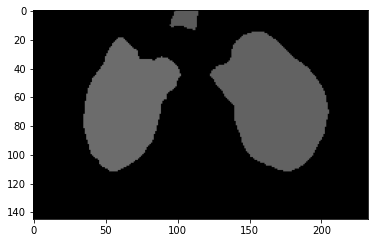

Non-Covid(520)


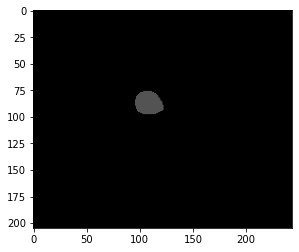

Covid(210)


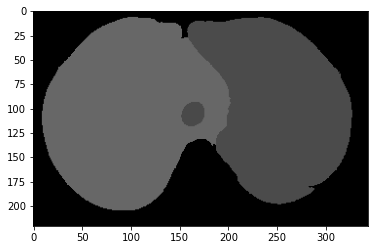

Non-Covid(170)


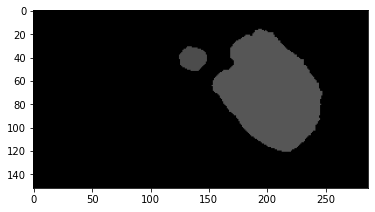

In [93]:
mode = ['COVID', 'non-COVID']
for x in ['train', 'val']:
    directory = os.path.join(path, x)
    for i in mode:
        mode_path = os.path.join(directory,i)
        fname = []
        for root,d_names,f_names in os.walk(mode_path):
            for f in f_names:
                fname.append(os.path.join(root, f))
        for i in fname:
            img = img_as_float(cv2.imread(i))
            
            edges = filters.sobel(color.rgb2gray(img))
            labels = slic(img, compactness=30, n_segments=100)
            g = graph.rag_boundary(labels, edges)
            plt.figure()
            labels2 = graph.cut_threshold(labels, g, thresh=0.08)
            
            
            out = color.label2rgb(labels2, img, kind='avg', bg_label=0)
            plt.imshow(out)
            filename = i.split(mode_path)[1].split('.')[0][1:].replace(" ", "")
            print(filename)

            if not os.path.exists(mode_path+'/'+x+'_masks'):
                os.makedirs(mode_path+'/'+x+'_masks')
            plt.savefig(mode_path+'/'+x+'_masks'+'/'+filename+'mask.png', format='png')
            plt.show()
            break

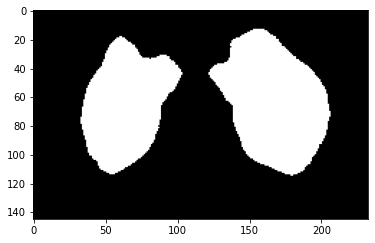

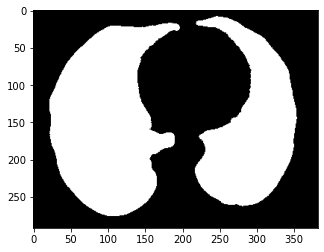

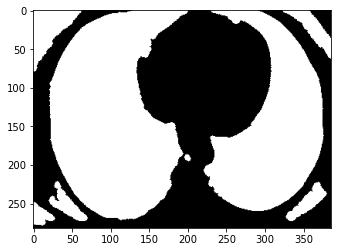

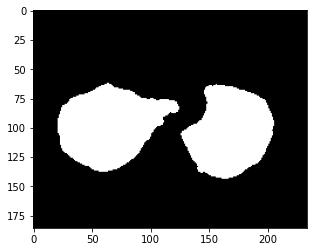

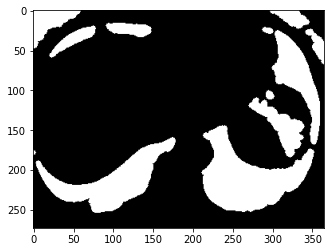

...

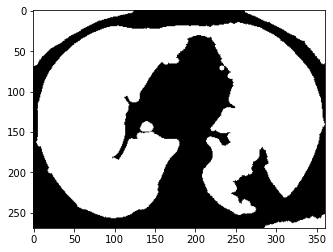

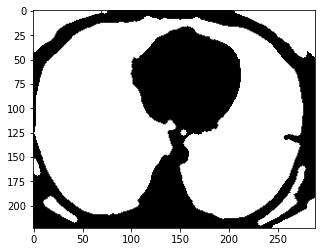

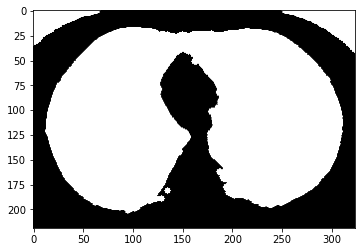

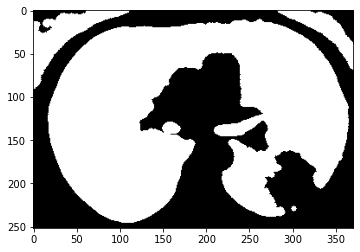

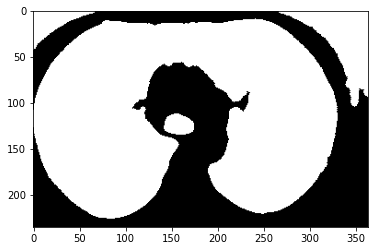

In [92]:
train_path
mode = ['COVID', 'non-COVID']
for x in ['train', 'val']:
    directory = os.path.join(path, x)
    for i in mode:
        mode_path = os.path.join(directory,i)
        filelist = os.listdir(mode_path)
        fname = [os.path.join(mode_path, x) for x in filelist if not (x.startswith('.'))]
#         for root,d_names,f_names in os.walk(mode_path):
#             for f in f_names:
#                 fname.append(os.path.join(root, f))
        for j in fname:
            image = (cv2.imread(j))
            
            # Compute a mask
            lum = color.rgb2gray(image)
            mask = morphology.remove_small_holes(
                morphology.remove_small_objects(
                    lum < 0.8, 500), 500)

            mask = morphology.opening(mask, morphology.disk(3))
            # maskSLIC result
            #m_slic = slic(image, n_segments=100, mask=mask, start_label=1)
            fig = plt.figure()
            ax = fig.add_subplot(1, 1, 1)
            #ax.imshow(mark_boundaries(image, m_slic))
            ax.imshow(mask, cmap="gray")
            #ax.set_title("Mask")
            
            filename = j.split(mode_path)[1].split('.')[0][1:].replace(" ", "")
            plt.show()
            if not os.path.exists(mode_path+'/'+i+'_masks'):
                os.makedirs(mode_path+'/'+i+'_masks')
            fig.savefig(mode_path+'/'+i+'_masks'+'/'+filename+'mask.png', format='png')
